In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sp
import scIB
import seaborn as sns

/home/icb/daniel.strobl/conda_scib/envs/scIB-python-2/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


In [3]:
plt.rcParams["font.family"] = "Source Sans 3"

In [4]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
plt.rcParams['figure.figsize'] = (15, 15)

In [5]:
plt.rcParams.update({'axes.titlesize': 'x-large'})

In [6]:
sns.set(font_scale=1.5, style='white')

In [7]:
sns.set_context('poster')

In [8]:
sns.set(font_scale=1.7)

In [9]:
sns.set_context("poster", rc={"axes.titlesize":60}) 

In [11]:
import pandas as pd

In [12]:
emb_1 = pd.read_csv('/storage/groups/ml01/projects/2020_scIB_malte.luecken/lung_atlas/embeddings/unscaled/full_feature/mnn_full.csv')

In [31]:
sns.set_style(style='white')

In [19]:
sns.set_palette(palette=sc.pl.palettes.godsnot_102)

In [25]:
emb_1

,CellID,cell_type,batch,UMAP1,UMAP2
0,GAGGGGCCAGCC-0,Type 2,0,5.532059,-4.786175
1,ACATAGATAGGC-0,Type 2,0,6.457159,-6.400319
2,ATCGACGCGGCA-0,Type 2,0,5.912804,-4.859516
3,CCAGCTTAGGTT-0,Type 2,0,5.749426,-6.552671
4,TCATAGAGTCCT-0,Type 2,0,5.974106,-6.937449
...,...,...,...,...,...
32467,LungTranscriptome7239218_GTCGTAAGTAGCTAAA-15,Mast cell,15,0.939782,1.962147
32468,LungTranscriptome7239218_GTCTCGTCACCAGATT-15,Mast cell,15,1.047913,1.896033
32469,LungTranscriptome7239218_GTTAAGCTCCGTAGTA-15,Mast cell,15,0.913778,1.834734
32470,LungTranscriptome7239218_GATCAGTGTTCGTTGA-15,Mast cell,15,2.949760,8.502084


[[]]

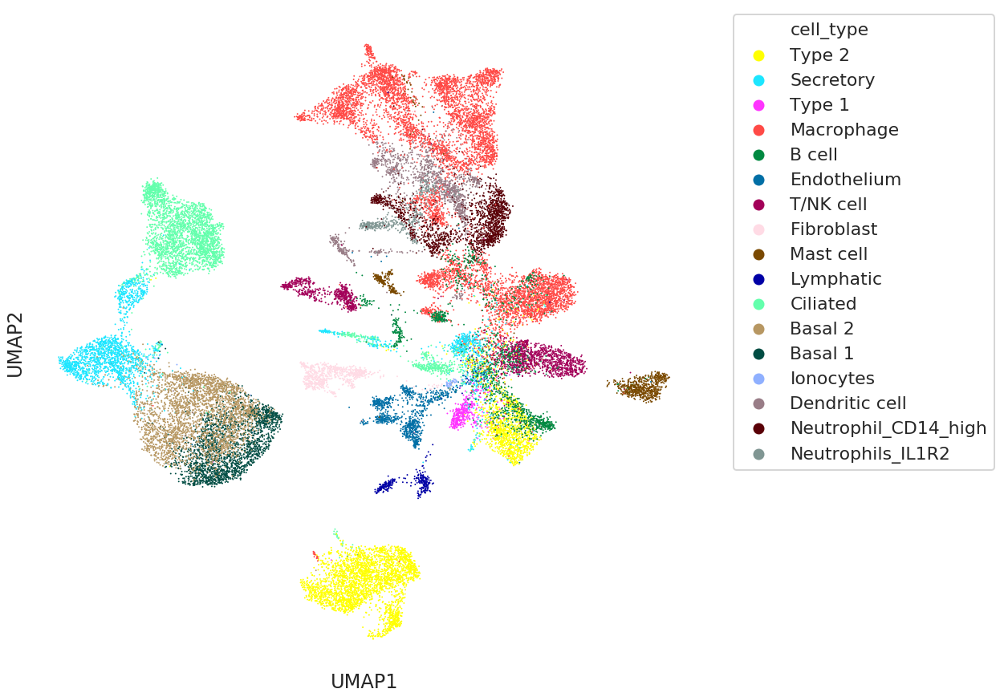

In [58]:
g = sns.scatterplot(data=emb_1, x='UMAP1', y='UMAP2', hue='cell_type', marker='.', linewidth=0, s=15)
sns.despine(left=True, bottom=True)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
g.set(yticks=[])
g.set(xticks=[])

# User input

In [100]:
orig_file = '/storage/groups/ml01/workspace/group.daniela/immune_cells/Immune_ALL_human.h5ad'
#files = ['integration/unscaled/hvg/R/conos.h5ad', 'integration/scaled/hvg/scanorama.h5ad', 'integration/unscaled/hvg/R/seurat.h5ad', 'integration/unscaled/hvg/scanorama.h5ad', 'integration/scaled/hvg/mnn.h5ad']
best = ['integration/unscaled/hvg/R/conos.h5ad', 'integration/scaled/hvg/scanorama.h5ad', 'integration/scaled/hvg/mnn.h5ad', 'integration/unscaled/hvg/R/seurat.h5ad']
worst = ['integration/unscaled/full_feature/R/harmony.h5ad', 'integration/unscaled/hvg/R/liger.h5ad', 'integration/unscaled/full_feature/trvae.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
best_names = ['Conos (unscaled/hvg)', 'Scanorama(embedding) (scaled/hvg)', 'MNN (unscaled/hvg)', 'Seurat (unscaled/hvg)']
worst_names=['Harmony (unscaled/full feature)', 'Liger (unscaled/hvg)', 'trVAE (unscaled/full feature)', 'scIV (unscaled/full feature)']
best_types = ['knn', 'emb', 'gene', 'gene']
worst_types = ['emb', 'emb', 'gene', 'emb']
batch_key = 'batch'
ct_key = 'final_annotation'

In [14]:
#Lung atlas
lung_base = '/storage/groups/ml01/projects/2020_scIB_malte.luecken/lung_atlas/embeddings/'
#lung_pre = '/storage/groups/ml01/workspace/group.daniela/lung/Lung_atlas_final_fixed.h5ad'
lung_best = ['unscaled/hvg/scgen', 'integration/unscaled/hvg/scanvi',  'integration/unscaled/hvg/seuratrpca', 'integration/unscaled/hvg/mnn']
lung_worst = ['integration/unscaled/full_feature/scanorama.h5ad', 'integration/scaled/hvg/R/seurat.h5ad', 'integration/unscaled/full_feature/scanorama.h5ad']
lung_best_types = ['full', 'emb', 'full', 'emb']
lung_worst_types = ['gene', 'gene', 'emb', 'emb']
lung_batch = 'batch'
lung_ct = 'cell_type'


In [11]:
lung_atlas = pd.read_csv('/home/icb/daniel.strobl/lung_atlas_summary_scores.csv')

In [74]:
la_top = lung_atlas.groupby(['Method','Output']).first().sort_values(by='Overall Score', ascending=False).head(n=4)

In [76]:
la_top.index

MultiIndex([(        'scGen*',  'gene'),
            (       'scANVI*', 'embed'),
            ('Seurat v3 RPCA',  'gene'),
            (     'Scanorama', 'embed')],
           names=['Method', 'Output'])

In [70]:
lung_atlas.groupby(['Method','Output']).last().sort_values(by='Overall Score', ascending=True).head(n=4)

Unnamed: 0 Features   Scaling  Overall Score  Batch Correction  \
Method Output                                                                   
LIGER  embed          316     FULL  unscaled       0.262975          0.423324   
SAUCIE gene           124     FULL  unscaled       0.330659          0.198354   
       embed          148     FULL  unscaled       0.358127          0.201488   
trVAE  gene           184     FULL  unscaled       0.457644          0.174789   

               PCR batch  Batch ASW  graph iLISI  graph connectivity  \
Method Output                                                          
LIGER  embed    0.880441   0.740180     0.253358            0.147814   
SAUCIE gene     0.000000   0.745190     0.152286            0.117555   
       embed    0.000000   0.754286     0.149179            0.119398   
trVAE  gene     0.000000   0.758423     0.000164            0.278886   

                   kBET  Bio conservation  NMI cluster/label  \
Method Output                                                  
LIGER  embed   0.005457          0.156076           0.139403   
SAUCIE gene    0.004781          0.418862           0.415957   
       embed   0.005981          0.462553           0.436291   
trVAE  gene    0.001424          0.646213           0.670767   

               ARI cluster/label  Cell type ASW  isolated label F1  \
Method Output                                                        
LIGER  embed            0.029787       0.412978           0.147180   
SAUCIE gene             0.228492       0.239947           0.438095   
       embed            0.234841       0.239980           0.437500   
trVAE  gene             0.332949       0.498131           0.537864   

               isolated label silhouette  graph cLISI  CC conservation  \
Method Output                                                            
LIGER  embed                    0.513547     0.781496         0.144502   
SAUCIE gene                     0.684117     0.925428         0.663192   
       embed                    0.684117     0.928590         0.663192   
trVAE  gene                     0.521103     0.998939         0.945314   

               HVG conservation  
Method Output                    
LIGER  embed                NaN  
SAUCIE gene            0.185073  
       embed                NaN  
trVAE  gene            0.517239

In [5]:
method_mapping = {'scGen*':'scgen', 'scANVI*':'scanvi', 'Seurat v3 RPCA':'seuratrpca', 'Scanorama':'scanorama', 'fastMNN':'fastmnn',
       'Conos':'conos', 'scVI':'scvi', 'Seurat v3 CCA':'seurat', 'MNN':'mnn', 'BBKNN':'bbknn', 'ComBat':'combat',
       'trVAE':'trvae', 'Harmony':'harmony', 'DESC':'desc', 'Unintegrated':'unintegrated', 'SAUCIE':'saucie', 'LIGER':'liger'}
output_mapping = {'gene':'full', 'embed':'embed', 'graph':'knn'}
feature_mapping = {'FULL':'full_feature', 'HVG':'hvg'}

In [6]:
def get_best_worst(df):
    top = df.groupby(['Method','Output']).first().sort_values(by='Overall Score', ascending=False).head(n=4)
    worst = df.groupby(['Method','Output']).last().sort_values(by='Overall Score', ascending=True).head(n=4)
    paths_top = {}
    paths_worst = {}
    for i in top.index:
        name = i[0]+" ("+i[1]+") "+top.loc[i]['Scaling']+"/"+top.loc[i]['Features']
        paths_top[name] = top.loc[i]['Scaling']+"/"+feature_mapping[top.loc[i]['Features']]+"/"+method_mapping[i[0]]+'_'+output_mapping[i[1]]+'.csv'
    for i in worst.index:
        name = i[0]+" ("+i[1]+") "+worst.loc[i]['Scaling']+"/"+worst.loc[i]['Features']
        paths_worst[name] = worst.loc[i]['Scaling']+"/"+feature_mapping[worst.loc[i]['Features']]+"/"+method_mapping[i[0]]+'_'+output_mapping[i[1]]+'.csv'
    return(paths_top, paths_worst)

In [39]:
#Immune cell human
imm_base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum/'
imm_pre = '/storage/groups/ml01/workspace/group.daniela/immune_cells/Immune_ALL_human.h5ad'
imm_best = ['integration/scaled/hvg/scanorama.h5ad', 'integration/unscaled/hvg/R/conos.h5ad', 'integration/unscaled/hvg/bbknn.h5ad', 'integration/unscaled/hvg/R/harmony.h5ad']
imm_worst = ['integration/unscaled/hvg/trvae.h5ad', 'integration/unscaled/full_feature/R/seurat.h5ad', 'integration/unscaled/hvg/R/liger.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
imm_best_types = ['emb', 'knn', 'knn', 'emb']
imm_worst_types = ['emb', 'gene', 'emb', 'emb']
imm_batch = 'batch'
imm_ct = 'final_annotation'


In [15]:
#Immune cell human mouse
imm2_base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum_mou/'
imm2_pre = '/storage/groups/ml01/workspace/group.daniela/immune_cells/Immune_ALL_hum_mou.h5ad'
imm2_best = ['integration/scaled/hvg/scanorama.h5ad', 'integration/unscaled/hvg/bbknn.h5ad', 'integration/unscaled/full_feature/combat.h5ad', 'integration/scaled/hvg/mnn.h5ad']
imm2_worst = ['integration/scaled/hvg/R/conos.h5ad', 'integration/unscaled/full_feature/R/harmony.h5ad', 'integration/unscaled/full_feature/R/liger.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
imm2_best_types = ['emb', 'knn', 'gene', 'gene']
imm2_worst_types = ['knn', 'emb', 'emb', 'emb']
imm2_batch = 'batch'
imm2_ct = 'final_annotation'

In [4]:
#Simulations 1
sim1_base = '/storage/groups/ml01/workspace/scIB/simulations_1_1/'
sim1_pre = '/storage/groups/ml01/workspace/scIB/simulations_1_1/sim1_1_norm.h5ad'
sim1_best = ['integration/unscaled/full_feature/scanorama.h5ad', 'integration/unscaled/full_feature/R/seurat.h5ad', 'integration/unscaled/hvg/mnn.h5ad', 'integration/scaled/full_feature/R/conos.h5ad']
sim1_worst = ['integration/scaled/full_feature/bbknn.h5ad', 'integration/unscaled/hvg/trvae.h5ad','integration/unscaled/full_feature/mnn.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
sim1_best_types = ['emb', 'gene', 'gene', 'knn']
sim1_worst_types = ['knn', 'emb', 'gene', 'emb']
sim1_batch = 'Batch'
sim1_ct = 'Group'


In [42]:
#Simulations 2
sim2_base = '/storage/groups/ml01/workspace/scIB/simulations_2/'
sim2_pre = '/storage/groups/ml01/workspace/scIB/simulations_2/sim2_norm.h5ad'
sim2_best = ['integration/scaled/hvg/R/seurat.h5ad', 'integration/scaled/hvg/R/harmony.h5ad', 'integration/scaled/full_feature/R/conos.h5ad',  'integration/unscaled/hvg/bbknn.h5ad']
sim2_worst = ['integration/unscaled/full_feature/combat.h5ad', 'integration/scaled/full_feature/scanorama.h5ad', 'integration/unscaled/full_feature/R/harmony.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
sim2_best_types = ['gene', 'emb', 'knn', 'knn']
sim2_worst_types = ['gene', 'gene', 'emb', 'emb']
sim2_batch = 'SubBatch'
sim2_ct = 'Group'


In [11]:
#Pancreas
panc_base = '/storage/groups/ml01/workspace/scIB/pancreas/'
panc_pre = '/storage/groups/ml01/workspace/maren.buettner/data_integration/data/human_pancreas/human_pancreas_norm.h5ad'
panc_best = ['integration/scaled/full_feature/R/conos.h5ad', 'integration/scaled/hvg/R/seurat.h5ad', 'integration/scaled/hvg/scanorama.h5ad',  'integration/scaled/hvg/R/harmony.h5ad']
panc_worst = ['integration/unscaled/full_feature/scanorama.h5ad', 'integration/unscaled/hvg/R/liger.h5ad','integration/unscaled/full_feature/R/harmony.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
panc_best_types = ['knn', 'gene', 'emb', 'emb']
panc_worst_types = ['gene', 'emb', 'emb', 'emb']
panc_batch = 'tech'
panc_ct = 'celltype'


In [13]:
#Pancreas
panc_base = '/storage/groups/ml01/workspace/scIB/pancreas_jointnorm/'
panc_pre = '/storage/groups/ml01/workspace/scIB/pancreas_joint/pancreas_jointnorm.h5ad'
panc_best = ['integration/unscaled/hvg/R/seurat.h5ad', 'integration/unscaled/hvg/bbknn.h5ad', 'integration/scaled/full_feature/R/conos.h5ad', 'integration/scaled/hvg/scanorama.h5ad']
panc_worst = ['integration/unscaled/full_feature/mnn.h5ad', 'integration/unscaled/full_feature/scanorama.h5ad', 'integration/unscaled/hvg/R/liger.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
panc_best_types = ['gene', 'knn', 'knn', 'emb']
panc_worst_types = ['gene', 'gene', 'emb', 'emb']
panc_batch = 'tech'
panc_ct = 'celltype'

In [53]:
# Mouse Brain
brain_base = '/home/icb/chaichoompu/Group/workspace/scib_result_rna_big_neu01_03/mouse_brain/'
brain_pre = '/storage/groups/ml01/workspace/maren.buettner/data_integration/data/mouse_brain/mouse_brain_norm.h5ad'
brain_best = ['integration/scaled/hvg/bbknn.h5ad', 'integration/unscaled/hvg/combat.h5ad', 'integration/unscaled/hvg/R/liger.h5ad',  'integration/scaled/hvg/scanorama.h5ad']
brain_worst = ['integration/unscaled/hvg/R/conos.h5ad', 'integration/unscaled/full_feature/R/harmony.h5ad','integration/unscaled/full_feature/scanorama.h5ad', 'integration/unscaled/full_feature/scvi.h5ad']
brain_best_types = ['knn', 'gene', 'emb', 'gene']
brain_worst_types = ['knn', 'emb', 'gene', 'emb']
brain_batch = 'study'
brain_ct = 'cell_type'

# Read files

In [7]:
def read_emb(csv, base):
    best, worst = get_best_worst(csv)
    best_emb = {}
    worst_emb = {}
    for i in best.keys():
        best_emb[i]= pd.read_csv(base+best[i])
    for i in worst.keys():
        worst_emb[i] = pd.read_csv(base+worst[i])
    return best_emb, worst_emb

In [115]:
best_emb, worst_emb = read_emb(lung_atlas, '/storage/groups/ml01/projects/2020_scIB_malte.luecken/lung_atlas/embeddings/')

In [29]:
# Visualization loop
def viz_emb(emb_best, emb_worst, var, axs, start=1, var_list=None):
    for i in emb_best:
        
        if var_list is not None:
            if (var_list.unique() == (emb_best[i][var].unique())).all() == False:
                print('changed var')
                emb_best[i][var]=var_list
        dim1 = emb_best[i].columns[3]
        dim2 = emb_best[i].columns[4]
        g = sns.scatterplot(data=emb_best[i], x=dim1, y=dim2, hue=var, marker='.', linewidth=0, s=15, ax=axs[start], legend=False)
        sns.despine(left=True, bottom=True)
        #plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
        g.set(yticks=[])
        g.set(xticks=[])
        g.set_ylabel("")
        g.set_xlabel("")
        g.set_title(i, fontsize=20)

        start+=1

    for i in emb_worst:
        
        if var_list is not None:
            if (var_list.unique() == emb_worst[i][var].unique()).all() == False:
                print('changed var')
                emb_worst[i][var]=var_list
        dim1 = emb_worst[i].columns[3]
        dim2 = emb_worst[i].columns[4]
        g = sns.scatterplot(data=emb_worst[i], x=dim1, y=dim2, hue=var, marker='.', linewidth=0, s=15, ax=axs[start], legend=False)
        sns.despine(left=True, bottom=True)
        #plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
        g.set(yticks=[])
        g.set(xticks=[])
        g.set_ylabel("")
        g.set_xlabel("")
        g.set_title(i, fontsize=20)
        start+=1
        
def make_grid():
    fig = plt.figure(constrained_layout=True, figsize=[40,24])
    gs = fig.add_gridspec(4, 7)
    axs = []
    axs.append(fig.add_subplot(gs[0:2,0:2]))
    axs.append(fig.add_subplot(gs[0,2]))
    axs.append(fig.add_subplot(gs[0,3]))
    axs.append(fig.add_subplot(gs[0,4]))
    axs.append(fig.add_subplot(gs[0,5]))
    axs.append(fig.add_subplot(gs[1,2]))
    axs.append(fig.add_subplot(gs[1,3]))
    axs.append(fig.add_subplot(gs[1,4]))
    axs.append(fig.add_subplot(gs[1,5]))
    axs.append(fig.add_subplot(gs[0:2,6]))
    
    axs.append(fig.add_subplot(gs[2:,0:2]))
    axs.append(fig.add_subplot(gs[2,2]))
    axs.append(fig.add_subplot(gs[2,3]))
    axs.append(fig.add_subplot(gs[2,4]))
    axs.append(fig.add_subplot(gs[2,5]))
    axs.append(fig.add_subplot(gs[3,2]))
    axs.append(fig.add_subplot(gs[3,3]))
    axs.append(fig.add_subplot(gs[3,4]))
    axs.append(fig.add_subplot(gs[3,5]))
    axs.append(fig.add_subplot(gs[2:,6]))
    return fig, axs

In [31]:
def draw_figure(csv, base):
    #fig, axs = make_grid()
    best_emb, worst_emb = read_emb(csv, base)
    unintegrated_emb = pd.read_csv(base+"/unscaled/full_feature/unintegrated_full.csv")
    ct_key = unintegrated_emb.columns[1]
    batch_key = unintegrated_emb.columns[2]
    
    
    fig, ax = make_grid()
    g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=ct_key, marker='.', linewidth=0, s=15, ax=ax[0],legend=False)
    sns.despine(left=True, bottom=True)
    #g.legend(bbox_to_anchor=(3.5, 0), loc=10, borderaxespad=0., fontsize=15)
    g.set(yticks=[])
    g.set(xticks=[])
    g.set_ylabel("")
    g.set_xlabel("")
    g.set_title('Cell Type', fontsize=40)
    g.text(-12.5, 12.5, 'a', fontsize=30)
    
    g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=ct_key, marker='.', linewidth=0, s=0, ax=ax[9])
    sns.despine(left=True, bottom=True)
    g.legend(loc=6, borderaxespad=0., fontsize=15, ncol=1, frameon=False, title="")
    g.set(yticks=[])
    g.set(xticks=[])
    g.set_ylabel("")
    g.set_xlabel("")
    viz_emb(best_emb, worst_emb, ct_key, ax)
    
    
    g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=batch_key, marker='.', linewidth=0, s=15, ax=ax[10],legend=False)
    sns.despine(left=True, bottom=True)
    #g.legend(bbox_to_anchor=(3.5, 0), loc=10, borderaxespad=0., fontsize=15)
    g.set(yticks=[])
    g.set(xticks=[])
    g.set_ylabel("")
    g.set_xlabel("")
    g.set_title('Batch', fontsize=40)
    g.text(-12.5, 12.5, 'b', fontsize=30)
    
    g = sns.scatterplot(data=unintegrated_emb, x='UMAP1', y='UMAP2', hue=batch_key, marker='.', linewidth=0, s=0, ax=ax[19])
    sns.despine(left=True, bottom=True)
    g.legend(loc=6, borderaxespad=0., fontsize=15, ncol=1, frameon=False, title="")
    g.set(yticks=[])
    g.set(xticks=[])
    g.set_ylabel("")
    g.set_xlabel("")
    viz_emb(best_emb, worst_emb, batch_key, ax, start=11, var_list= unintegrated_emb[batch_key])

    fig.savefig(base+'/figure_400.png', dpi=400)
    fig.savefig(base+'/figure_150.png', dpi=150)
    #fig.savefig(base+'/figure.svg')
    
    '''
    fig_2, axs_2 = make_grid()
    sc.pl.umap(a_pre, title="Cell type", color=ct, frameon=False, ax=axs_2[0])
    viz(a_best, a_worst, ct, axs=axs_2)
    return a_best, a_worst'''

changed var


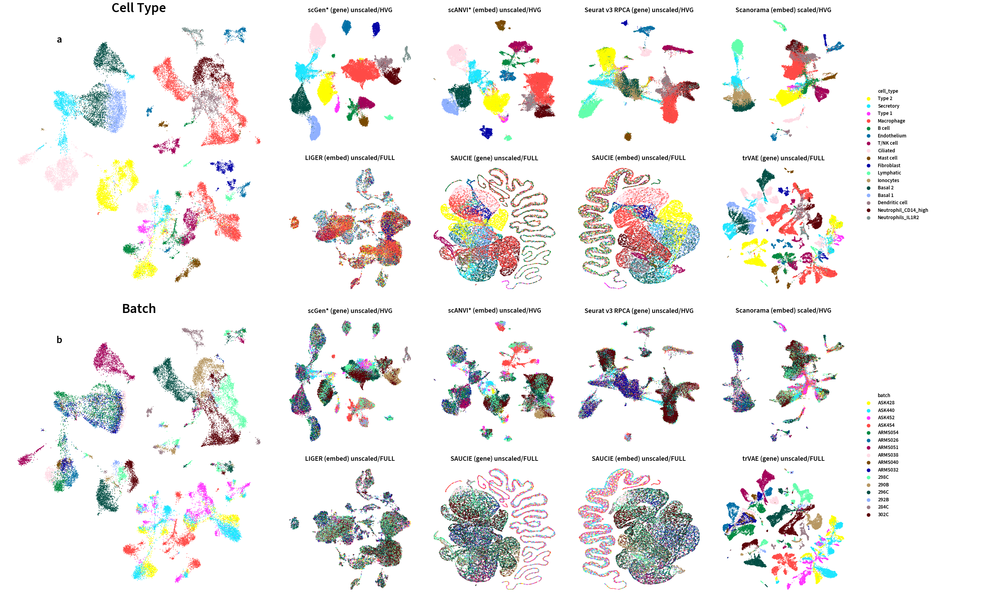

In [20]:
draw_figure(lung_atlas, '/storage/groups/ml01/projects/2020_scIB_malte.luecken/lung_atlas/embeddings/')

In [290]:
pd.read_csv('/storage/groups/ml01/projects/2020_scIB_malte.luecken/lung_atlas/embeddings/scaled/hvg/scanorama_embed.csv')

,CellID,cell_type,batch,UMAP1,UMAP2
0,GAGGGGCCAGCC-0,Type 2,0,4.976426,-3.770027
1,ACATAGATAGGC-0,Type 2,0,4.257440,-4.223118
2,ATCGACGCGGCA-0,Type 2,0,4.702748,-3.945231
3,CCAGCTTAGGTT-0,Type 2,0,2.509315,-4.050460
4,TCATAGAGTCCT-0,Type 2,0,4.222721,-4.789940
...,...,...,...,...,...
32467,LungTranscriptome7239218_GTCGTAAGTAGCTAAA-15,Mast cell,15,12.151279,1.300346
32468,LungTranscriptome7239218_GTCTCGTCACCAGATT-15,Mast cell,15,12.118734,1.301925
32469,LungTranscriptome7239218_GTTAAGCTCCGTAGTA-15,Mast cell,15,12.201433,1.358543
32470,LungTranscriptome7239218_GATCAGTGTTCGTTGA-15,Mast cell,15,11.477423,0.921463


In [282]:
emb_1.columns[2]

'batch'

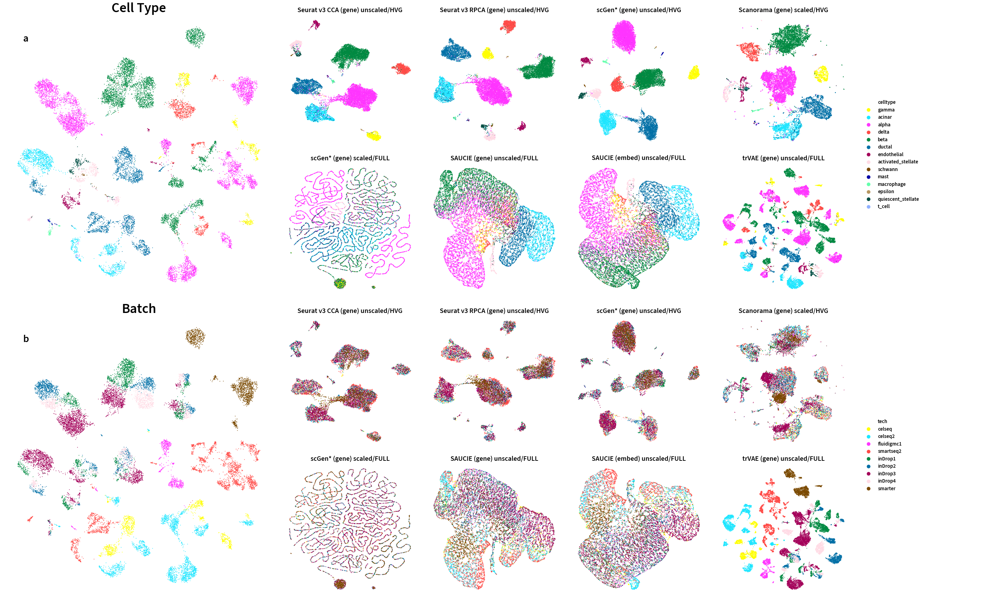

In [21]:
draw_figure(pd.read_csv('~/pancreas_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/pancreas/embeddings/')

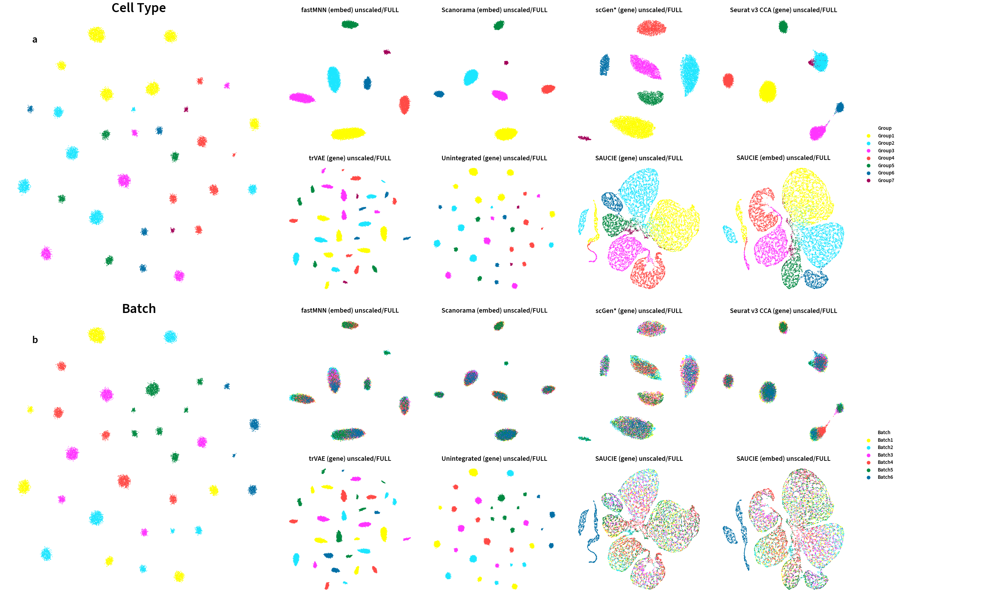

In [22]:
draw_figure(pd.read_csv('~/simulations_1_1_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/simulations_1_1/embeddings/')

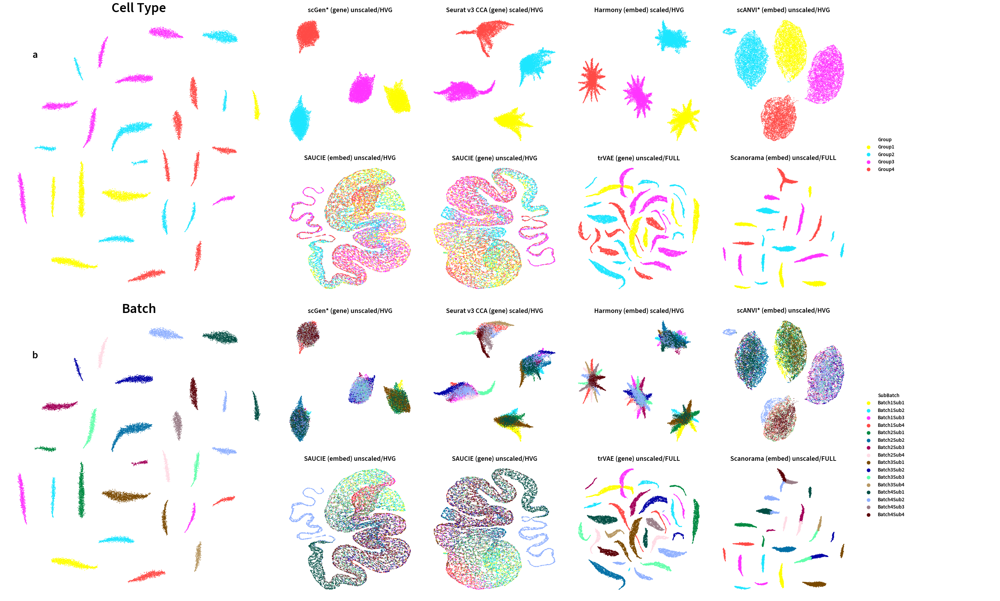

In [23]:
draw_figure(pd.read_csv('~/simulations_2_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/simulations_2/embeddings/')

changed var
changed var


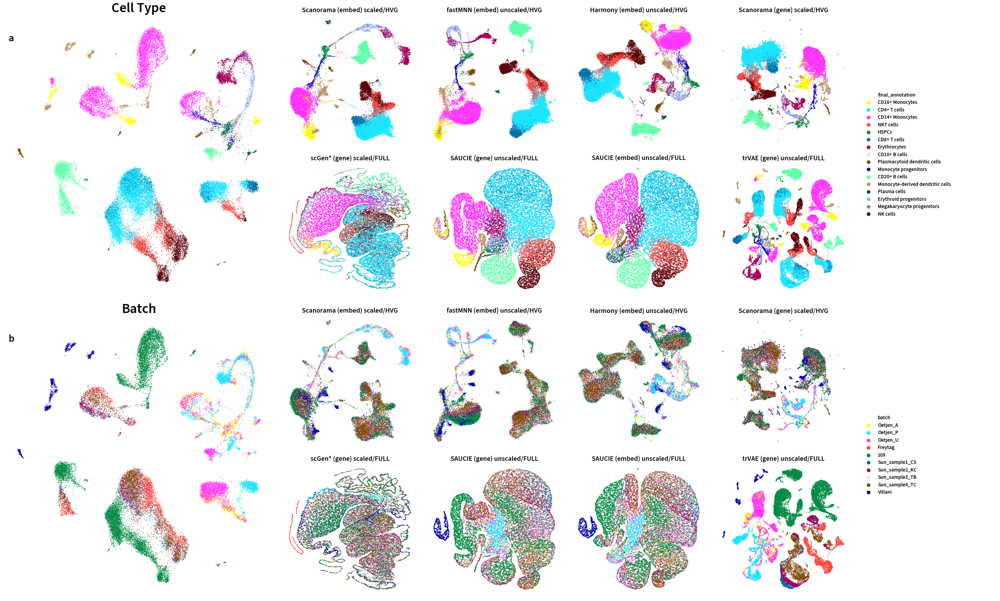

In [24]:
draw_figure(pd.read_csv('~/immune_cell_hum_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/immune_cell_hum/embeddings/')

In [26]:
pd.read_csv('/storage/groups/ml01/projects/2020_scIB_malte.luecken/immune_cell_hum_mou/embeddings/unscaled/hvg/conos_knn.csv')

,CellID,final_annotation,batch,Graph1,Graph2
0,AAACCTGCAGCGAACA-1-Oetjen_A,Monocytes,Oetjen_A,-5804.468028,-5783.109398
1,AAACCTGCATGTCCTC-1-Oetjen_A,CD4+ T cells,Oetjen_A,14218.736080,22850.541421
2,AAACCTGGTCGACTGC-1-Oetjen_A,Monocytes,Oetjen_A,-2416.350160,-12300.070396
3,AAACCTGGTCGCTTCT-1-Oetjen_A,Monocytes,Oetjen_A,-1504.899440,-13471.302110
4,AAACCTGTCCCGACTT-1-Oetjen_A,NKT cells,Oetjen_A,14983.985614,17305.582095
...,...,...,...,...,...
97856,BoneMarrowcKit_2.CTCGCAAGGACTAGGGTC,Neutrophils,MCA_BM_2,-20245.171173,-24918.468163
97857,BoneMarrowcKit_2.GTATACTATGTAGGTACA,Neutrophils,MCA_BM_2,-19909.364539,-23100.190031
97858,BoneMarrowcKit_2.TCGGGTCGGCAGGAACGC,Neutrophils,MCA_BM_2,-19879.707380,-23322.313328
97859,BoneMarrowcKit_2.TGATCATATGTAACCTGA,Neutrophils,MCA_BM_2,-16360.596629,-22361.734950


changed var


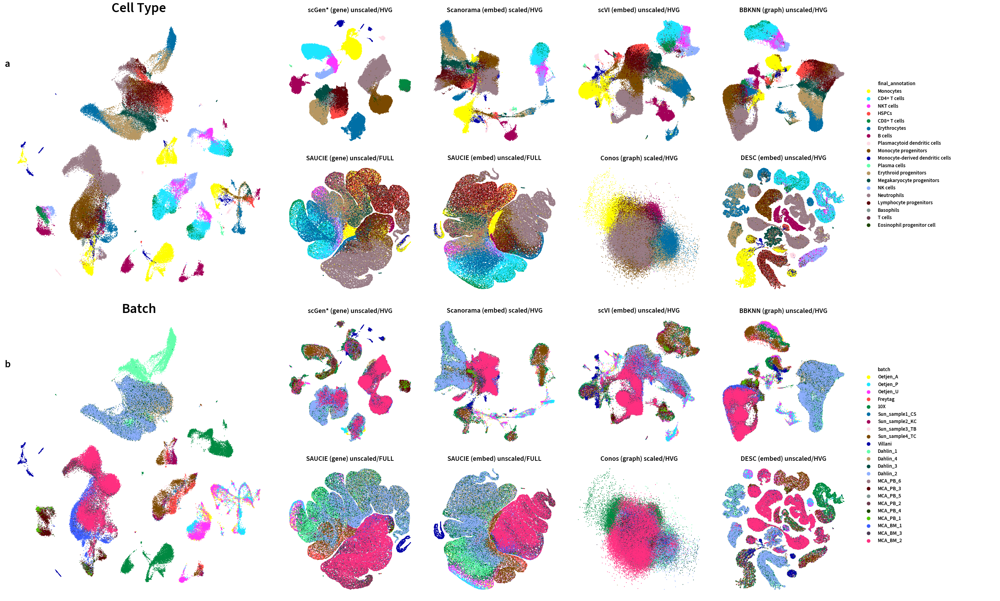

In [30]:
draw_figure(pd.read_csv('~/immune_cell_hum_mou_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/immune_cell_hum_mou/embeddings/')

In [32]:
draw_figure(pd.read_csv('~/mouse_brain_summary_scores.csv'), '/storage/groups/ml01/projects/2020_scIB_malte.luecken/mouse_brain/embeddings/')

FileNotFoundError: [Errno 2] No such file or directory: '/storage/groups/ml01/projects/2020_scIB_malte.luecken/mouse_brain/embeddings/unscaled/hvg/combat_full.csv'

In [6]:
def make_names(fnames):
    names = []
    for i in fnames:
        s = i.split('/')
        names.append(s[len(s)-1].split(".")[0] +" ("+s[1]+"/"+s[2]+")")
    return names

In [7]:
def read_data(base, pre, best, worst, best_types, worst_types):
    adata_pre = sc.read(pre)
    adatas_best = dict()
    adatas_worst = dict()
    best_names = make_names(best)
    worst_names = make_names(worst)
    for idx,file in enumerate(best):
        adatas_best[best_names[idx]] = (sc.read(base+file), best_types[idx])
    for idx,file in enumerate(worst):
        adatas_worst[worst_names[idx]] = (sc.read(base+file), worst_types[idx])
    return adata_pre, adatas_best, adatas_worst

In [8]:
# Transfer annotations from pervious object
def match_anns(adata, adata_pre, batch_key='batch'):
    # Match annotations:
    if len(set(adata_pre.obs_names).difference(set(adata.obs_names))) > 0:
        new_obs_names = ['-'.join(idx.split('-')[:-1]) for idx in adata.obs_names]
        if len(set(adata_pre.obs_names).difference(set(new_obs_names))) == 0:
            adata.obs_names = new_obs_names
        else:
            raise ValueError('obs_names changed after integration!')

    adata.obs[batch_key] = adata.obs[batch_key].astype('category')

    if not np.array_equal(adata_pre.obs[batch_key].cat.categories,adata.obs[batch_key].cat.categories):
        adata.obs[batch_key] = adata_pre.obs[batch_key]


In [9]:
# Preprocessing loop
def pp(adatas, a_pre, batch_key):
    for key in adatas:
        print(f'preprocessing {key}...')
        ot = adatas[key][1]
        dat = adatas[key][0]
    
        # Ensure annotations are matched
        match_anns(dat, a_pre, batch_key)
    
        if ot == 'knn':
            if 'params' not in dat.uns['neighbors']:
                dat.uns['neighbors']['params'] = dict(n_pcs=dat.obsm['X_pca'].shape[1],
                                                      use_rep='X_pca',
                                                      metric='cosine',
                                                      method='umap',
                                                      n_neighbors=10)
            
            sc.tl.umap(dat)
        
        elif ot == 'emb':
            scIB.pp.reduce_data(dat, n_top_genes=None, neighbors=True, use_rep='X_emb', pca=True, umap=True)
        
        elif ot == 'gene':
            if key.startswith('tr'):
                sc.pp.filter_genes(dat, min_cells=1)
            scIB.pp.reduce_data(dat, n_top_genes=2000, neighbors=True, use_rep='X_pca', pca=True, umap=True)
        if key.startswith('conos'):
            print('conos comp graph')
            sc.tl.draw_graph(dat)

In [75]:
# Visualization loop
def viz(adatas_best, adatas_worst, var, axs):
    #fig, axs = plt.subplots(2, 4, figsize=(40,16))
    start = 1
    for key in adatas_best:
        dat = adatas_best[key][0]
        if key.startswith('con'):
            print('conos draw graph')
            sc.pl.draw_graph(dat, color=var, size=20, title=key, legend_loc="", legend_fontsize='x-large', ax=axs[start], show=False, frameon=False)
        else:
            sc.pl.umap(dat, color=var, size=20, title=key, legend_loc="", legend_fontsize='x-large', ax=axs[start], show=False, frameon=False)
        start+=1
    #start=0
    for key in adatas_worst:
        dat = adatas_worst[key][0]
        
        if key.startswith('con'):
            print('conos draw graph')
            sc.pl.draw_graph(dat, color=var, size=20, title=key, legend_loc="", legend_fontsize='x-large', ax=axs[start], show=False, frameon=False)

        sc.pl.umap(dat, color=var, size=20, title=key, legend_loc="", legend_fontsize='x-large', ax=axs[start], show=False, frameon=False)
        start+=1
    #plt.savefig('figures/integrated.svg')
        #sc.pl.umap(dat, color=ct_key, size=20, title=key)

In [216]:
def make_grid():
    fig = plt.figure(constrained_layout=True, figsize=[40,12])
    gs = fig.add_gridspec(2, 7)
    axs = []
    axs.append(fig.add_subplot(gs[:,0:2]))
    axs.append(fig.add_subplot(gs[0,2]))
    axs.append(fig.add_subplot(gs[0,3]))
    axs.append(fig.add_subplot(gs[0,4]))
    axs.append(fig.add_subplot(gs[0,5]))
    axs.append(fig.add_subplot(gs[1,2]))
    axs.append(fig.add_subplot(gs[1,3]))
    axs.append(fig.add_subplot(gs[1,4]))
    axs.append(fig.add_subplot(gs[1,5]))
    axs.append(fig.add_subplot(gs[0,6]))
    return fig, axs

In [89]:
def draw_figure(base, pre, best, worst, best_types, worst_types, batch, ct):
    a_pre, a_best, a_worst = read_data(base, pre, best, worst, best_types, worst_types)
    print('Data reading successful')
    scIB.pp.reduce_data(a_pre, n_top_genes=2000, neighbors=True, use_rep='X_pca', pca=True, umap=True)
    pp(a_best, a_pre, batch)
    pp(a_worst, a_pre, batch)
    fig, axs = make_grid()
    sc.pl.umap(a_pre, title="Batch", color=batch, frameon=False, ax=axs[0])
    viz(a_best, a_worst, batch, axs=axs)
    fig_2, axs_2 = make_grid()
    sc.pl.umap(a_pre, title="Cell type", color=ct, frameon=False, ax=axs_2[0])
    viz(a_best, a_worst, ct, axs=axs_2)
    return a_best, a_worst

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing seurat (unscaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing bbknn (unscaled/hvg)...
preprocessing conos (scaled/full_feature)...
conos comp graph
preprocessing scanorama (scaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing mnn (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scanorama (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing liger (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

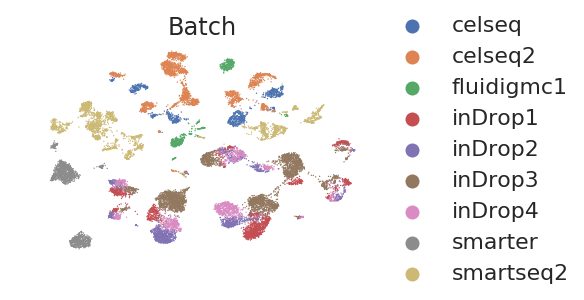

conos draw graph


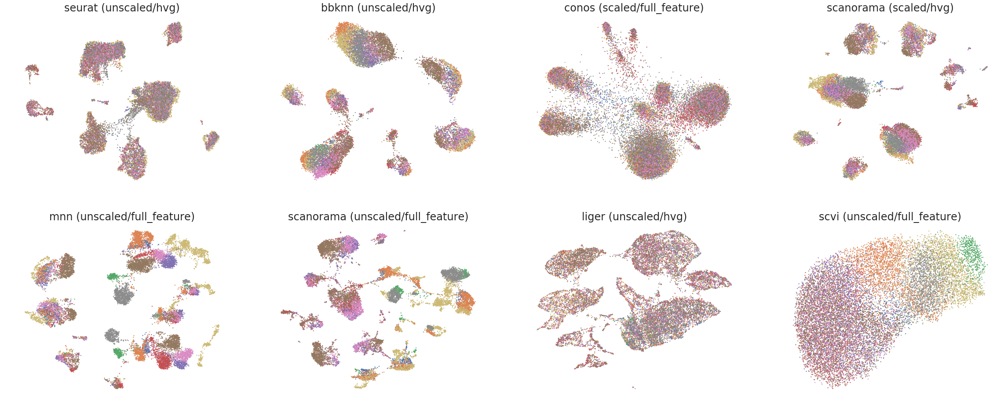

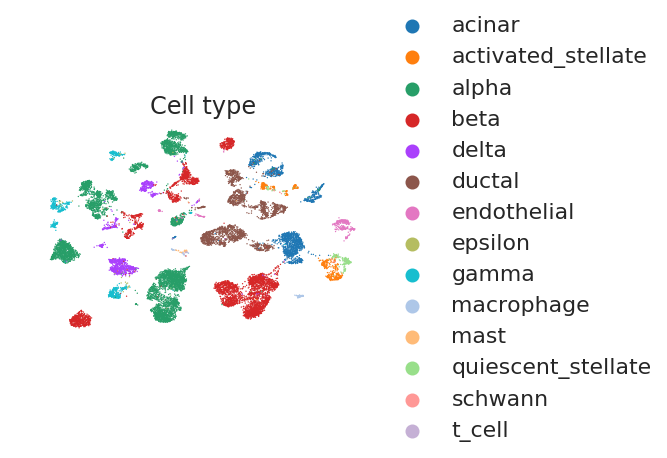

conos draw graph


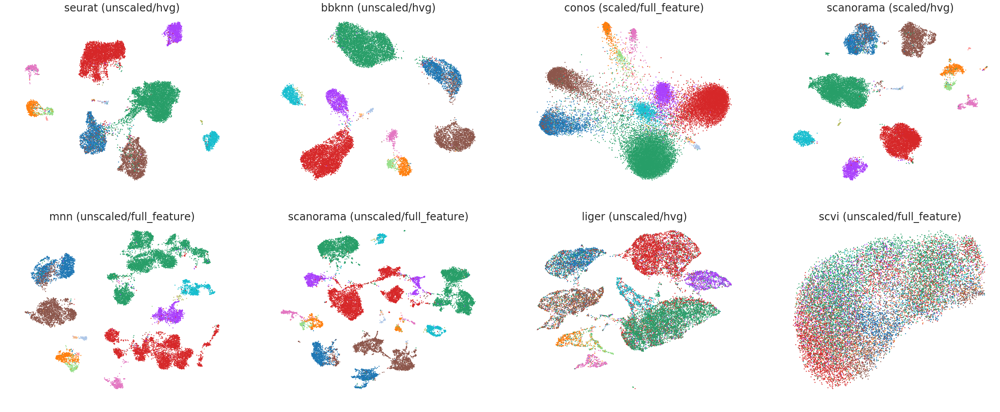

In [36]:
# panc jointnorm
draw_figure(panc_base, panc_pre, panc_best, panc_worst, panc_best_types, panc_worst_types, panc_batch, panc_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py (457)

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee

UMAP
preprocessing conos (unscaled/full_feature)...
conos comp graph
preprocessing bbknn (unscaled/hvg)...
preprocessing scanorama (scaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py (457)

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee

UMAP
preprocessing mnn (unscaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scanorama (scaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 13 separate connected components using meta-embedding (experimental)
  n_components


preprocessing seurat (scaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py (457)

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee

UMAP
preprocessing liger (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


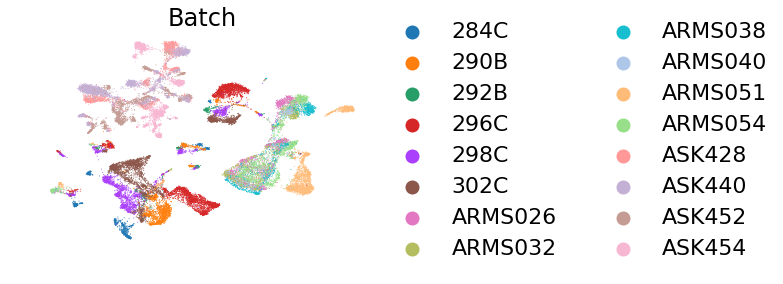

conos draw graph


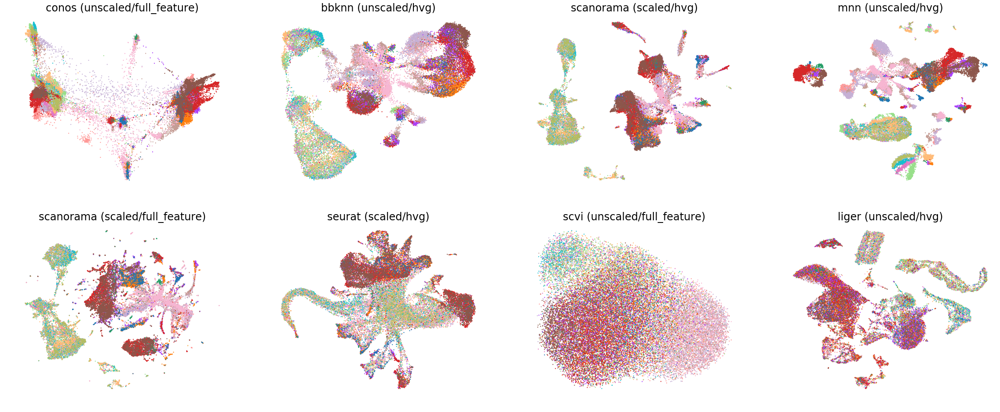

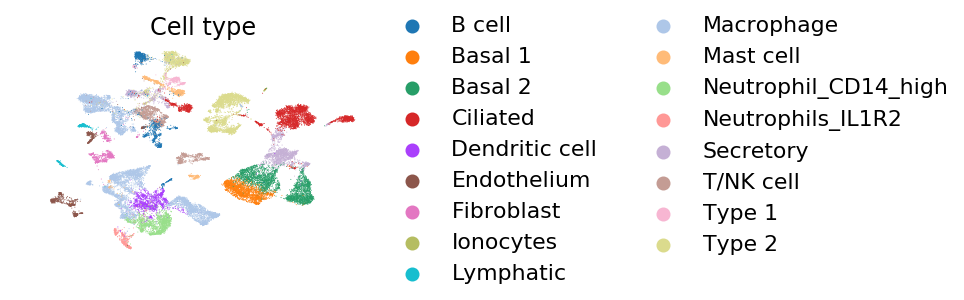

conos draw graph


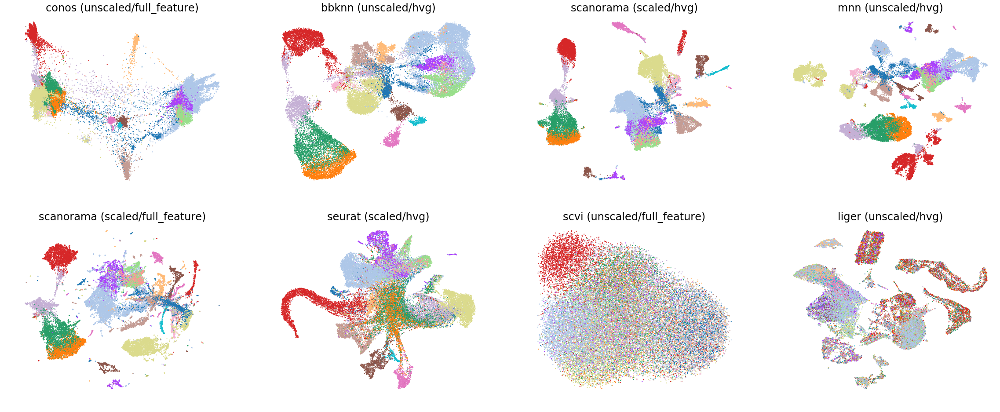

In [12]:
draw_figure(lung_base, lung_pre, lung_best, lung_worst, lung_best_types, lung_worst_types, lung_batch, lung_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 3 separate connected components using meta-embedding (experimental)
  n_components


preprocessing scanorama (scaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing conos (unscaled/hvg)...
conos comp graph
preprocessing bbknn (unscaled/hvg)...
preprocessing harmony (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing trvae (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing seurat (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing liger (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

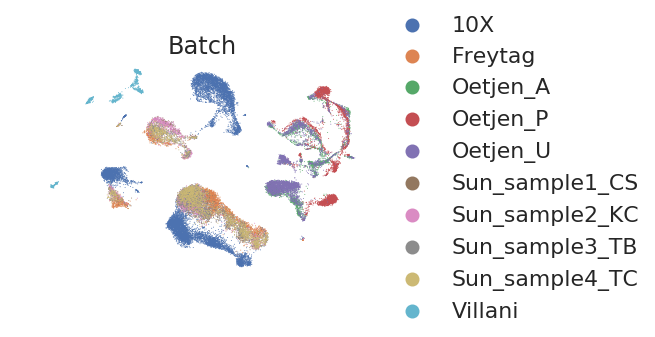

conos draw graph


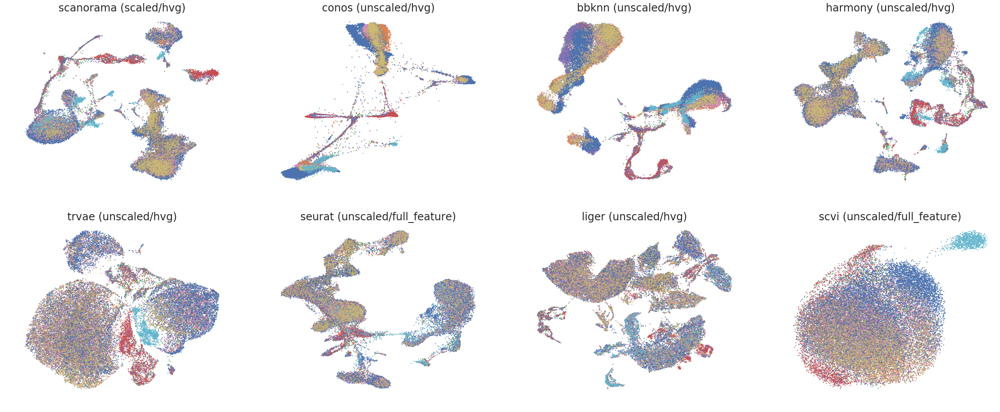

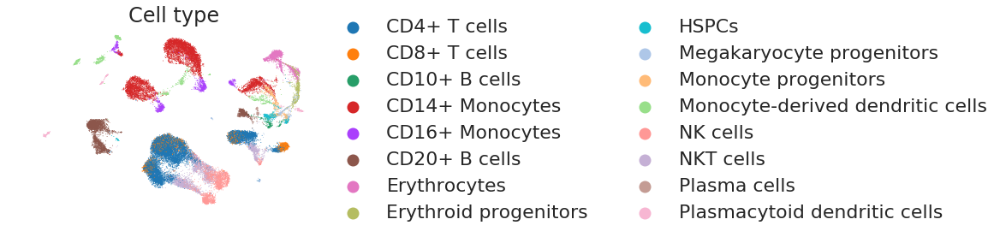

conos draw graph


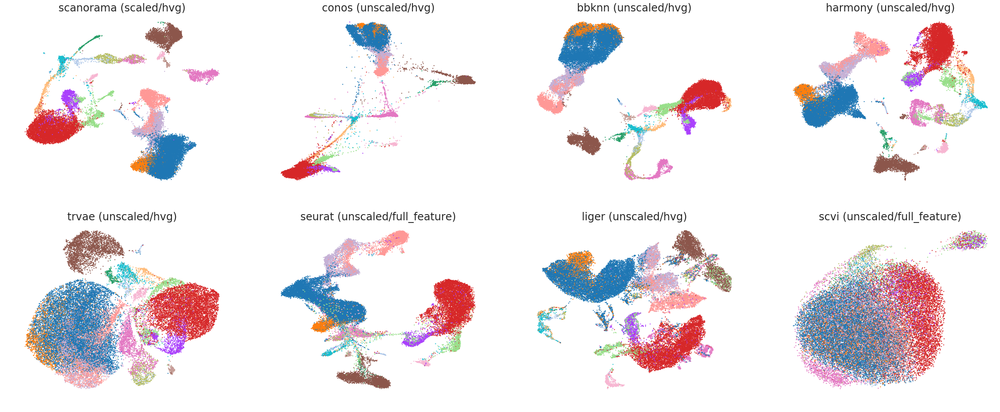

In [40]:
draw_figure(imm_base, imm_pre, imm_best, imm_worst, imm_best_types, imm_worst_types, imm_batch, imm_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours
UMAP
preprocessing scanorama (scaled/hvg)...
PCA
Nearest Neigbours
UMAP
preprocessing bbknn (unscaled/hvg)...
preprocessing combat (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours
UMAP
preprocessing mnn (scaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours
UMAP
preprocessing conos (scaled/hvg)...
conos comp graph
preprocessing harmony (unscaled/full_feature)...
PCA
Nearest Neigbours
UMAP
preprocessing liger (unscaled/full_feature)...
PCA
Nearest Neigbours
UMAP
preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours
UMAP


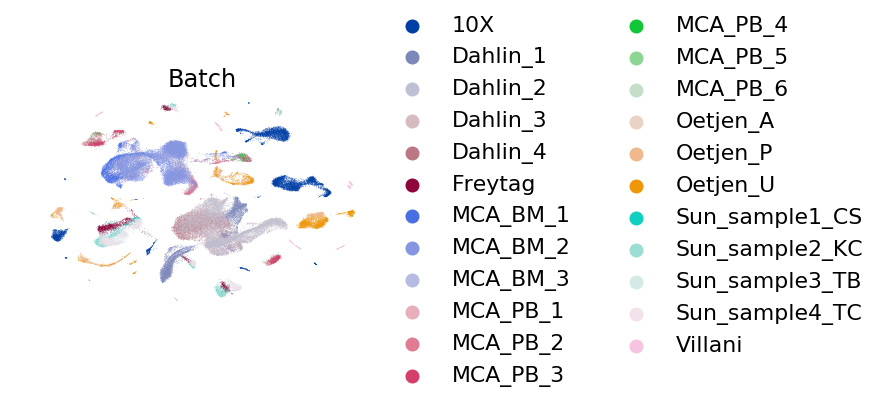

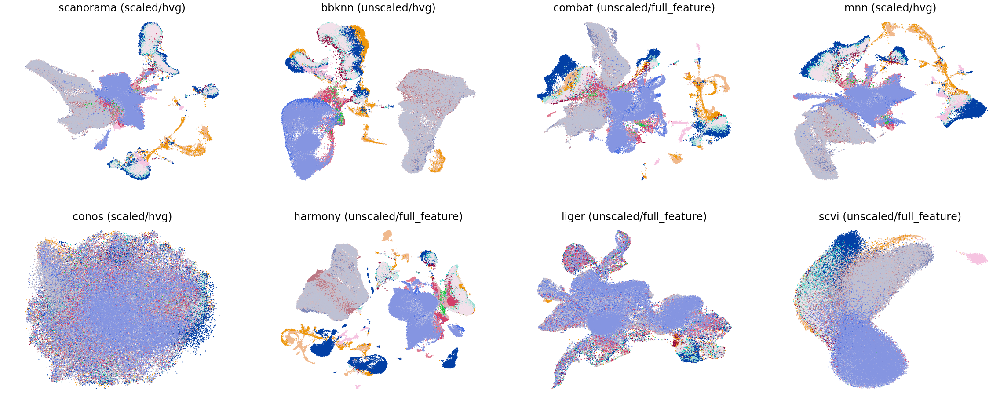

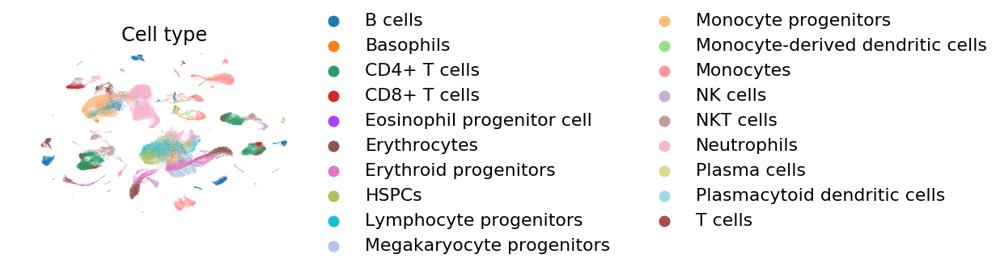

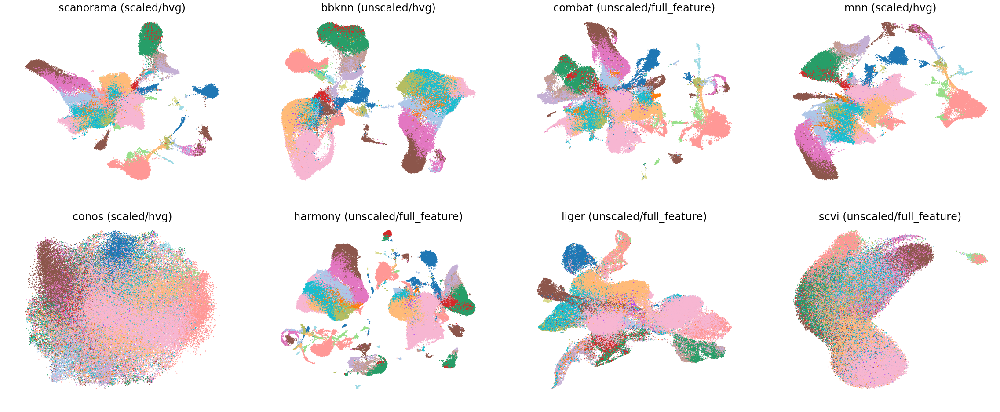

In [19]:
imm2best, imm2worst = draw_figure(imm2_base, imm2_pre, imm2_best, imm2_worst, imm2_best_types, imm2_worst_types, imm2_batch, imm2_ct)

In [52]:
imm2_u = sc.read(imm2_pre)
scIB.pp.reduce_data(imm2_u)

HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours
UMAP


conos draw graph


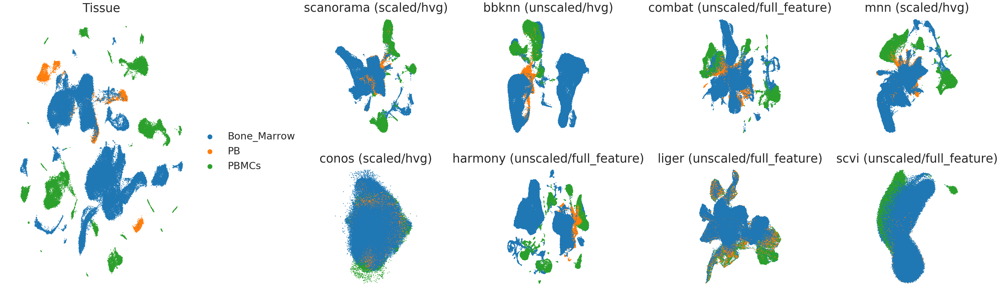

In [98]:
fig, axs = make_grid()

sc.pl.umap(imm2_u, color='tissue', size=20, title='Tissue', legend_fontsize='large', frameon=False, show=False, ax=axs[0])
viz(imm2best, imm2worst, 'tissue', axs)
plt.savefig('imm2_tissue.pdf')

In [102]:
imm2_u.obs.to_csv('imm_cell_hum.csv')

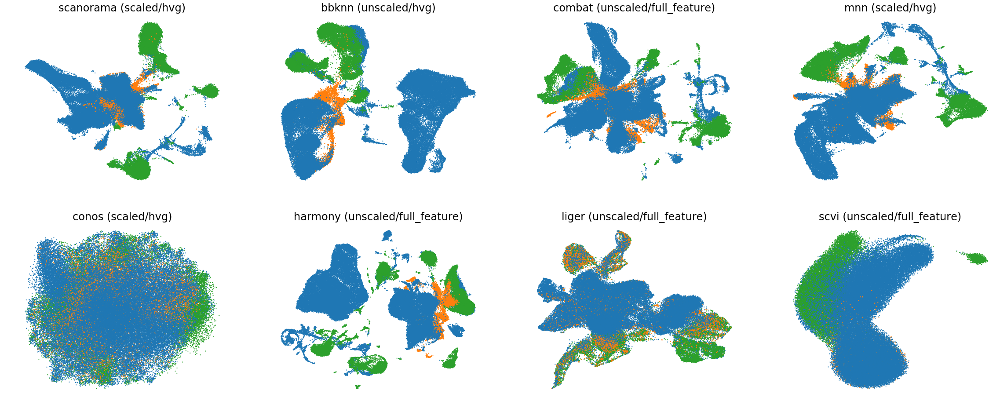

In [49]:
viz(imm2best, imm2worst, 'tissue')

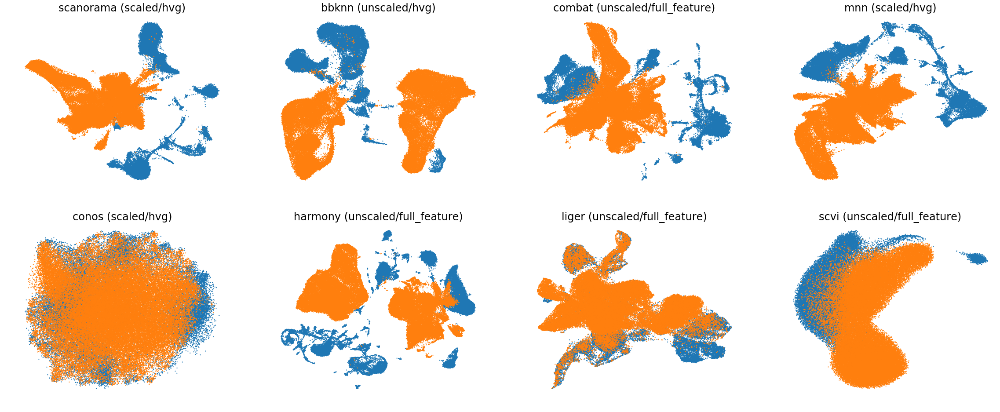

In [50]:
viz(imm2best, imm2worst, 'species')

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 30 separate connected components using meta-embedding (experimental)
  n_components


preprocessing scanorama (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 7 separate connected components using meta-embedding (experimental)
  n_components


preprocessing seurat (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


preprocessing mnn (unscaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 5 separate connected components using meta-embedding (experimental)
  n_components


preprocessing conos (scaled/full_feature)...
conos comp graph
preprocessing bbknn (scaled/full_feature)...
preprocessing trvae (unscaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP
preprocessing mnn (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 6 separate connected components using meta-embedding (experimental)
  n_components


preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


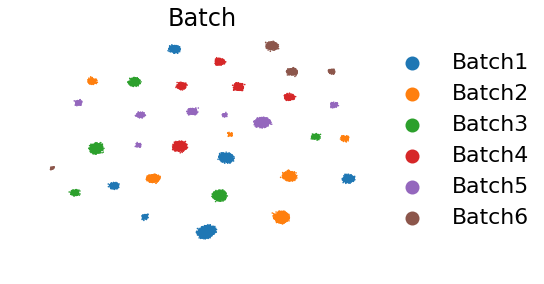

conos draw graph


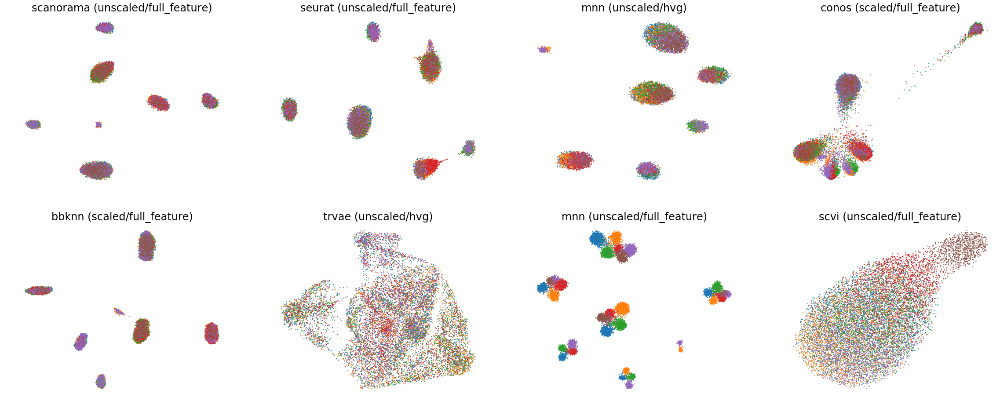

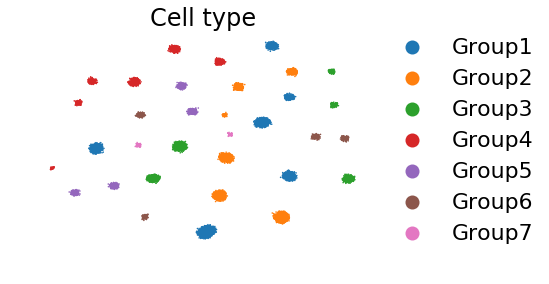

conos draw graph


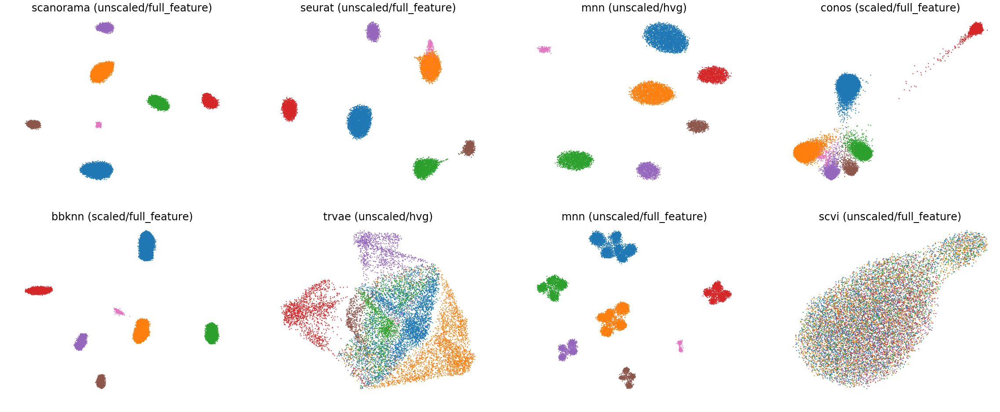

In [13]:
draw_figure(sim1_base, sim1_pre, sim1_best, sim1_worst, sim1_best_types, sim1_worst_types, sim1_batch, sim1_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 14 separate connected components using meta-embedding (experimental)
  n_components


preprocessing seurat (scaled/hvg)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


preprocessing harmony (scaled/hvg)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


preprocessing conos (scaled/full_feature)...
conos comp graph
preprocessing bbknn (unscaled/hvg)...
preprocessing combat (unscaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 8 separate connected components using meta-embedding (experimental)
  n_components


preprocessing scanorama (scaled/full_feature)...
HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 6 separate connected components using meta-embedding (experimental)
  n_components


preprocessing harmony (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 10 separate connected components using meta-embedding (experimental)
  n_components
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/sklearn/manifold/_spectral_embedding.py:236: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


preprocessing scvi (unscaled/full_feature)...
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


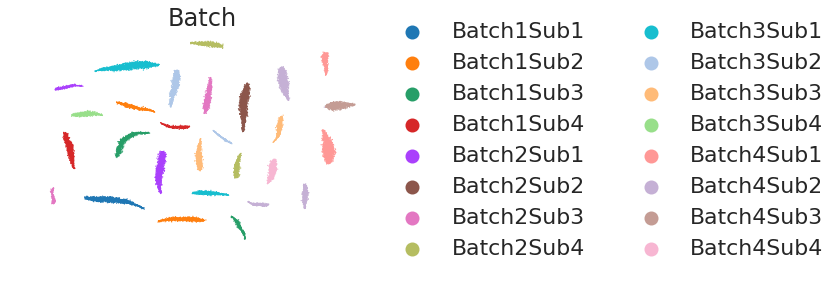

conos draw graph


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

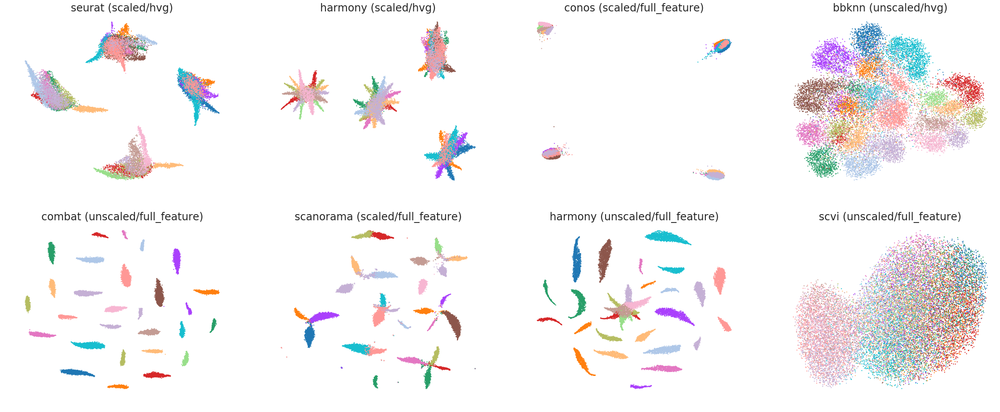

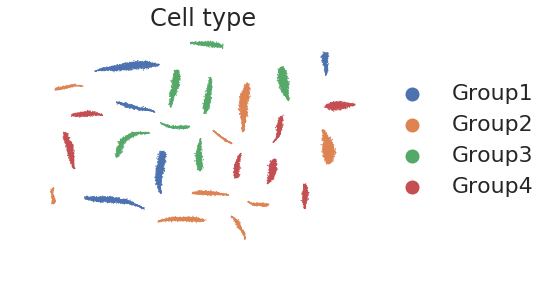

conos draw graph


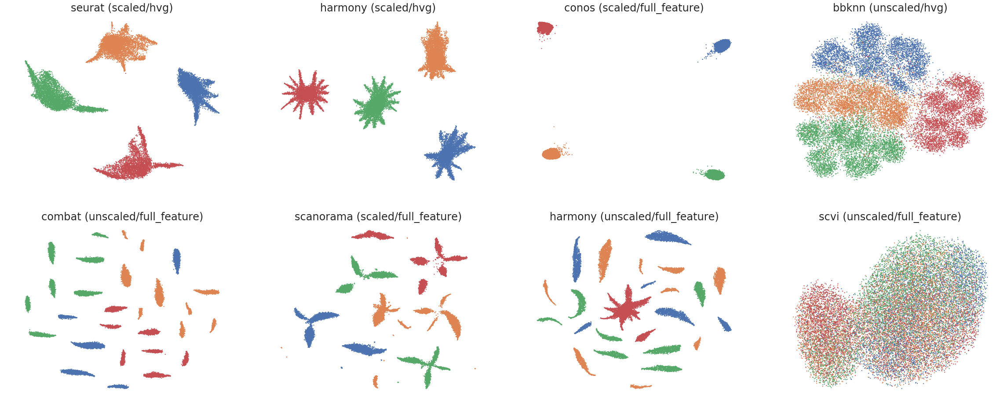

In [44]:
draw_figure(sim2_base, sim2_pre, sim2_best, sim2_worst, sim2_best_types, sim2_worst_types, sim2_batch, sim2_ct)

In [54]:
draw_figure(brain_base, brain_pre, brain_best, brain_worst, brain_best_types, brain_worst_types, brain_batch, brain_ct)

Data reading successful
HVG
Calculating 2000 HVGs for reduce_data.


MemoryError: Unable to allocate array with shape (1068535623,) and data type float32